In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix
from torchvision import transforms
from transformers import ViTForImageClassification, ViTFeatureExtractor
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import time
import cv2

#Setup YOLOv8 for Training



In [ ]:
pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 896.9/896.9 kB 14.4 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO

# Load YOLO model
model = YOLO('yolov8n.pt')  # Use the 'nano' version for speed or 'yolov8m.pt' for higher accuracy

# Train YOLO model
model.train(
    data="/content/drive/MyDrive/rail separate.v2i.yolov8/data.yaml",  # Path to your YOLOv8 dataset YAML
    epochs=50,  # Adjust as needed
    imgsz=640,  # Image size
    batch=16,   # Adjust based on GPU memory
    project="/content/drive/MyDrive/YOLOv8_Results1",  # Output directory
    name="rail_defects"
)

# Evaluate Model
metrics = model.val()
print(metrics)

# Export Trained Model for Inference
model.export(format='onnx')  # Export for compatibility with deployment


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 96.1MB/s]


Ultralytics 8.3.39 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/rail separate.v2i.yolov8/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/YOLOv8_Results1, name=rail_defects3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_

100%|██████████| 755k/755k [00:00<00:00, 20.5MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 102MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/rail separate.v2i.yolov8/train/labels.cache... 168 images, 0 backgrounds, 0 corrupt: 100%|██████████| 168/168 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/rail separate.v2i.yolov8/valid/labels.cache... 16 images, 0 backgrounds, 0 corrupt: 100%|██████████| 16/16 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/YOLOv8_Results1/rail_defects3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/YOLOv8_Results1/rail_defects3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.24G      1.583      2.936      1.681         18        640: 100%|██████████| 11/11 [00:07<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

                   all         16         16    0.00333          1      0.783      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.14G     0.8888      1.607      1.158         19        640: 100%|██████████| 11/11 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]

                   all         16         16    0.00333          1      0.778       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.17G     0.8747      1.243      1.146         20        640: 100%|██████████| 11/11 [00:03<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all         16         16      0.435        0.5      0.399       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.14G     0.8062      1.156       1.09         20        640: 100%|██████████| 11/11 [00:04<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.03it/s]

                   all         16         16          1      0.864      0.978      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.14G     0.8437      1.048      1.115         22        640: 100%|██████████| 11/11 [00:02<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]

                   all         16         16      0.862          1      0.966      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.14G     0.8097     0.9536      1.081         26        640: 100%|██████████| 11/11 [00:02<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.56it/s]

                   all         16         16      0.548      0.688      0.792      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.15G     0.8201     0.9913       1.11         23        640: 100%|██████████| 11/11 [00:02<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.24it/s]

                   all         16         16          1      0.997      0.995      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.14G       0.81     0.9235      1.091         19        640: 100%|██████████| 11/11 [00:06<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all         16         16      0.997          1      0.995      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.15G     0.8622     0.9158      1.099         18        640: 100%|██████████| 11/11 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         16         16       0.93          1      0.991      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.14G     0.8023     0.9472      1.097         22        640: 100%|██████████| 11/11 [00:02<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all         16         16      0.992          1      0.995      0.906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.14G     0.8488     0.8639      1.103         26        640: 100%|██████████| 11/11 [00:03<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all         16         16      0.914      0.875       0.96      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.14G     0.7768     0.8227      1.066         21        640: 100%|██████████| 11/11 [00:04<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         16         16       0.75      0.688      0.664      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.15G     0.7885      0.774      1.072         21        640: 100%|██████████| 11/11 [00:02<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.04it/s]

                   all         16         16      0.649      0.812      0.723      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.14G     0.7446     0.7528      1.059         26        640: 100%|██████████| 11/11 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.33it/s]

                   all         16         16      0.791          1       0.91      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.14G     0.7536     0.7349      1.072         17        640: 100%|██████████| 11/11 [00:04<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]

                   all         16         16      0.931      0.938      0.952      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.14G     0.7124     0.6754      1.049         27        640: 100%|██████████| 11/11 [00:03<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all         16         16      0.995          1      0.995      0.914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.15G     0.7113     0.6437      1.021         27        640: 100%|██████████| 11/11 [00:02<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.37it/s]


                   all         16         16      0.995          1      0.995      0.879

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.14G     0.7135     0.6911      1.045         15        640: 100%|██████████| 11/11 [00:02<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all         16         16      0.896      0.938      0.988      0.887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.14G     0.6844     0.6762       1.02         27        640: 100%|██████████| 11/11 [00:03<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all         16         16      0.886      0.938      0.981      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.14G       0.74     0.6809      1.052         17        640: 100%|██████████| 11/11 [00:04<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

                   all         16         16      0.996          1      0.995      0.898



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.15G     0.6539     0.6054      1.002         17        640: 100%|██████████| 11/11 [00:03<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.63it/s]


                   all         16         16      0.994          1      0.995      0.909

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.14G      0.622     0.5776     0.9922         20        640: 100%|██████████| 11/11 [00:02<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all         16         16      0.992          1      0.995      0.891



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.14G     0.6407     0.5719      1.007         21        640: 100%|██████████| 11/11 [00:03<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all         16         16      0.995          1      0.995      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.14G     0.6659     0.5928      1.013         17        640: 100%|██████████| 11/11 [00:04<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]

                   all         16         16      0.995          1      0.995      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.15G      0.609     0.5305     0.9762         23        640: 100%|██████████| 11/11 [00:02<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         16         16      0.988          1      0.995      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.14G     0.6216     0.5298      1.017         21        640: 100%|██████████| 11/11 [00:02<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.99it/s]

                   all         16         16      0.991          1      0.995      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.14G     0.6156     0.5355     0.9931         21        640: 100%|██████████| 11/11 [00:03<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]

                   all         16         16      0.996          1      0.995      0.866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.14G      0.612     0.5207     0.9797         22        640: 100%|██████████| 11/11 [00:04<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all         16         16      0.997          1      0.995      0.922



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.15G     0.5715     0.5109     0.9677         24        640: 100%|██████████| 11/11 [00:02<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         16         16      0.997          1      0.995      0.923



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.15G     0.5635     0.4858     0.9577         21        640: 100%|██████████| 11/11 [00:02<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all         16         16      0.996          1      0.995      0.918



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.14G     0.5519     0.4706     0.9765         19        640: 100%|██████████| 11/11 [00:03<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]

                   all         16         16      0.997          1      0.995      0.922



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.14G     0.5438     0.4543     0.9652         21        640: 100%|██████████| 11/11 [00:04<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         16         16      0.997          1      0.995      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.15G     0.5251     0.4554     0.9641         22        640: 100%|██████████| 11/11 [00:02<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]

                   all         16         16      0.992          1      0.995      0.912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.14G     0.5495     0.4805     0.9741         18        640: 100%|██████████| 11/11 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.11it/s]


                   all         16         16      0.997          1      0.995      0.938

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.14G     0.5316     0.4416     0.9684         21        640: 100%|██████████| 11/11 [00:03<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]

                   all         16         16      0.995          1      0.995      0.941



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.14G     0.5016      0.426     0.9508         24        640: 100%|██████████| 11/11 [00:04<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.25it/s]

                   all         16         16      0.997          1      0.995      0.932



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.15G     0.5183     0.4557     0.9712         16        640: 100%|██████████| 11/11 [00:02<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         16         16      0.997          1      0.995      0.952



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.14G      0.499      0.423     0.9524         21        640: 100%|██████████| 11/11 [00:02<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         16         16      0.997          1      0.995      0.936



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.14G     0.5236     0.4504     0.9626         19        640: 100%|██████████| 11/11 [00:03<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]

                   all         16         16      0.997          1      0.995       0.93



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.15G     0.5013     0.4381     0.9742         21        640: 100%|██████████| 11/11 [00:03<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.42it/s]

                   all         16         16      0.997          1      0.995      0.938


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.15G      0.415     0.6251     0.9894          8        640: 100%|██████████| 11/11 [00:04<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         16         16      0.997          1      0.995      0.929



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.15G     0.3599     0.4461     0.9411          8        640: 100%|██████████| 11/11 [00:02<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all         16         16      0.996          1      0.995      0.945



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.14G       0.34     0.4346     0.9066          8        640: 100%|██████████| 11/11 [00:04<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         16         16      0.995          1      0.995      0.934



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.15G     0.3164     0.3743     0.9042          8        640: 100%|██████████| 11/11 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all         16         16      0.996          1      0.995       0.94



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.15G     0.3182     0.3543     0.8839          8        640: 100%|██████████| 11/11 [00:02<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         16         16      0.997          1      0.995      0.926



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.15G     0.3019     0.3351     0.8799          8        640: 100%|██████████| 11/11 [00:02<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]

                   all         16         16      0.997          1      0.995      0.935



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.14G     0.3277     0.3528     0.9259          8        640: 100%|██████████| 11/11 [00:03<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all         16         16      0.997          1      0.995      0.904



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.15G     0.3042     0.3328     0.9265          8        640: 100%|██████████| 11/11 [00:03<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.99it/s]

                   all         16         16      0.997          1      0.995      0.896



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.15G     0.3107     0.3393     0.9135          8        640: 100%|██████████| 11/11 [00:02<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         16         16      0.997          1      0.995      0.896



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.15G     0.2862     0.3131     0.9005          8        640: 100%|██████████| 11/11 [00:02<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.54it/s]

                   all         16         16      0.997          1      0.995      0.911



50 epochs completed in 0.072 hours.
Optimizer stripped from /content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/last.pt, 6.2MB
Optimizer stripped from /content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt, 6.2MB

Validating /content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt...
Ultralytics 8.3.39 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.68it/s]


                   all         16         16      0.997          1      0.995      0.952
Speed: 0.2ms preprocess, 2.6ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /content/drive/MyDrive/YOLOv8_Results1/rail_defects3
Ultralytics 8.3.39 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/MyDrive/rail separate.v2i.yolov8/valid/labels.cache... 16 images, 0 backgrounds, 0 corrupt: 100%|██████████| 16/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.19it/s]


                   all         16         16      0.997          1      0.995      0.952
Speed: 0.4ms preprocess, 6.2ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to /content/drive/MyDrive/YOLOv8_Results1/rail_defects32
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79b90ba4bd00>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,

'/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.onnx'

# Crop new IP

In [ ]:
from ultralytics import YOLO
import cv2
import os

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to your trained model

# Define the new image database directory
input_images_path = "/content/drive/MyDrive/FotosDefeitos1"  # Directory with new images
output_crops_path = "/content/drive/MyDrive/FotosDefeitos1/CroppedRails"   # Directory to save cropped rail images
os.makedirs(output_crops_path, exist_ok=True)  # Create output directory if it doesn't exist

# Loop through all images in the input directory
for image_name in os.listdir(input_images_path):
    # Full path to the input image
    image_path = os.path.join(input_images_path, image_name)

    # Read the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error loading {image_name}, skipping...")
        continue

    # Run inference
    results = model(image)

    # Process the results
    for idx, box in enumerate(results[0].boxes):
        # Get bounding box coordinates (x1, y1, x2, y2)
        x1, y1, x2, y2 = map(int, box.xyxy[0])

        # Crop the rail area from the image
        cropped_rail = image[y1:y2, x1:x2]

        # Define the output path for the cropped image
        crop_filename = f"{os.path.splitext(image_name)[0]}_crop{idx + 1}.jpg"
        crop_output_path = os.path.join(output_crops_path, crop_filename)

        # Save the cropped image
        cv2.imwrite(crop_output_path, cropped_rail)

    print(f"Processed and saved crops for {image_name}")



0: 480x640 1 rail, 183.2ms
Speed: 4.3ms preprocess, 183.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
Processed and saved crops for 15422_Cod471.jpg

0: 480x640 (no detections), 167.1ms
Speed: 5.5ms preprocess, 167.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Processed and saved crops for 17069_Cod211.jpg

0: 480x640 2 rails, 153.1ms
Speed: 5.2ms preprocess, 153.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
Processed and saved crops for 19567_Cod471.jpg

0: 384x640 1 rail, 144.7ms
Speed: 5.6ms preprocess, 144.7ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)
Processed and saved crops for 19973_Cod211.jpg

0: 480x640 1 rail, 159.8ms
Speed: 5.3ms preprocess, 159.8ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
Processed and saved crops for 15180_Cod471.jpg

0: 480x640 (no detections), 183.3ms
Speed: 5.0ms preprocess, 183.3ms inference, 0.6ms postprocess per image at shape (1, 3, 

In [ ]:
from ultralytics import YOLO
import cv2
import os

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to your trained model

# Define the new image database directory
input_images_path = "/content/drive/MyDrive/Railway iran"  # Directory with new images
output_path = "/content/drive/MyDrive/Railway iran/CroppedRails"   # Directory to save cropped rail images
os.makedirs(output_path, exist_ok=True)

# List all images in the new images folder
image_files = [f for f in os.listdir(input_images_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Process each image
for img_file in image_files:
    # Load the image
    img_path = os.path.join(input_images_path, img_file)
    img = cv2.imread(img_path)

    # Perform inference with adjusted confidence threshold
    results = model(img, conf=0.25)  # Lower threshold to 0.25 for more detections

    # Check if any detections were made
    if len(results[0].boxes) == 0:
        print(f"No rails detected in {img_file}. Skipping.")
        continue

    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {img_file}: {bbox}")
            continue

        # Crop the rail area
        cropped_img = img[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(img_file)[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

    print(f"Processed {img_file} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")



0: 480x640 (no detections), 257.2ms
Speed: 4.8ms preprocess, 257.2ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
No rails detected in 4.jpeg. Skipping.

0: 480x640 (no detections), 269.8ms
Speed: 4.7ms preprocess, 269.8ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
No rails detected in 2.jpeg. Skipping.

0: 480x640 (no detections), 249.8ms
Speed: 5.4ms preprocess, 249.8ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
No rails detected in 3.jpeg. Skipping.

0: 640x480 1 rail, 265.7ms
Speed: 4.4ms preprocess, 265.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)
Processed 1.jpeg and saved cropped rail areas.

0: 640x480 1 rail, 165.6ms
Speed: 4.5ms preprocess, 165.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)
Processed 5.jpeg and saved cropped rail areas.

0: 640x384 2 rails, 152.4ms
Speed: 4.2ms preprocess, 152.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Proce

In [ ]:
from ultralytics import YOLO
import cv2
import os

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to your trained model

# Define the new image database directory
input_images_path = "/content/drive/MyDrive/FotosDefeitos"  # Directory with new images
output_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails5"   # Directory to save cropped rail images
os.makedirs(output_path, exist_ok=True)

# List all images in the new images folder
image_files = [f for f in os.listdir(input_images_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Desired image size for YOLO model (should match the size used during training)
resize_width = 640
resize_height = 640

# Process each image
for img_file in image_files:
    # Load the image
    img_path = os.path.join(input_images_path, img_file)
    img = cv2.imread(img_path)

    # Resize the image to the desired size
    resized_img = cv2.resize(img, (resize_width, resize_height))  # Resize to 640x640 or your preferred size

    # Perform inference with adjusted confidence threshold
    results = model(resized_img, conf=0.25)  # Lower threshold to 0.25 for more detections

    # Check if any detections were made
    if len(results[0].boxes) == 0:
        print(f"No rails detected in {img_file}. Skipping.")
        continue

    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {img_file}: {bbox}")
            continue

        # Crop the rail area from the resized image
        cropped_img = resized_img[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(img_file)[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

    print(f"Processed {img_file} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")



0: 640x640 1 rail, 363.3ms
Speed: 5.3ms preprocess, 363.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Processed 15422_Cod471.jpg and saved cropped rail areas.

0: 640x640 1 rail, 275.8ms
Speed: 4.2ms preprocess, 275.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Processed 19567_Cod471.jpg and saved cropped rail areas.

0: 640x640 1 rail, 221.5ms
Speed: 4.2ms preprocess, 221.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Processed 19973_Cod211.jpg and saved cropped rail areas.

0: 640x640 2 rails, 212.2ms
Speed: 3.7ms preprocess, 212.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Processed 15180_Cod471.jpg and saved cropped rail areas.

0: 640x640 (no detections), 213.0ms
Speed: 2.8ms preprocess, 213.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
No rails detected in 17069_Cod211.jpg. Skipping.

0: 640x640 (no detections), 234.9ms
Speed: 5.0ms preprocess, 234.9ms inference, 0.

In [ ]:
from ultralytics import YOLO
import cv2
import os

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to the trained weights

# Path to the input image
input_image_path = '/content/drive/MyDrive/FotosDefeitos/17069_Cod211.jpg'  # Replace with the path to your image

# Path to save cropped rail areas
output_path = '/content/drive/MyDrive/FotosDefeitos/Cropped_Rail_Areaspic1/'  # Folder to save cropped rail areas
os.makedirs(output_path, exist_ok=True)

# Path to save detection visualizations
visualization_path = '/content/drive/MyDrive/FotosDefeitos/Detection_Visualizations/'
os.makedirs(visualization_path, exist_ok=True)

# Load the image
img = cv2.imread(input_image_path)

# Check if the image is loaded successfully
if img is None:
    print(f"Error: Failed to load image: {input_image_path}")
else:
    print(f"Image loaded successfully: {input_image_path}")

# Perform inference with adjusted confidence threshold
results = model(img, conf=0.25)  # Lower threshold to 0.25 for more detections

# Visualize and save detections (if any)
for idx, result in enumerate(results):  # Iterate over the list of results
    result.show()  # Display detections on the image
    # Save visualizations to a specified path
    save_path = os.path.join(visualization_path, f"detection_{idx}.jpg")
    result.save(save_path)  # Save visualizations for review

# Check if any detections were made
if len(results[0].boxes) == 0:
    print(f"No rails detected in {input_image_path}.")
else:
    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers
        conf = float(results[0].boxes.conf[i])  # Confidence score

        # Print detection details for debugging
        print(f"Detection {i}: Bounding box {bbox}, Confidence: {conf}")

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {input_image_path}: {bbox}")
            continue

        # Crop the rail area
        cropped_img = img[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(os.path.basename(input_image_path))[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

    print(f"Processed {input_image_path} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")

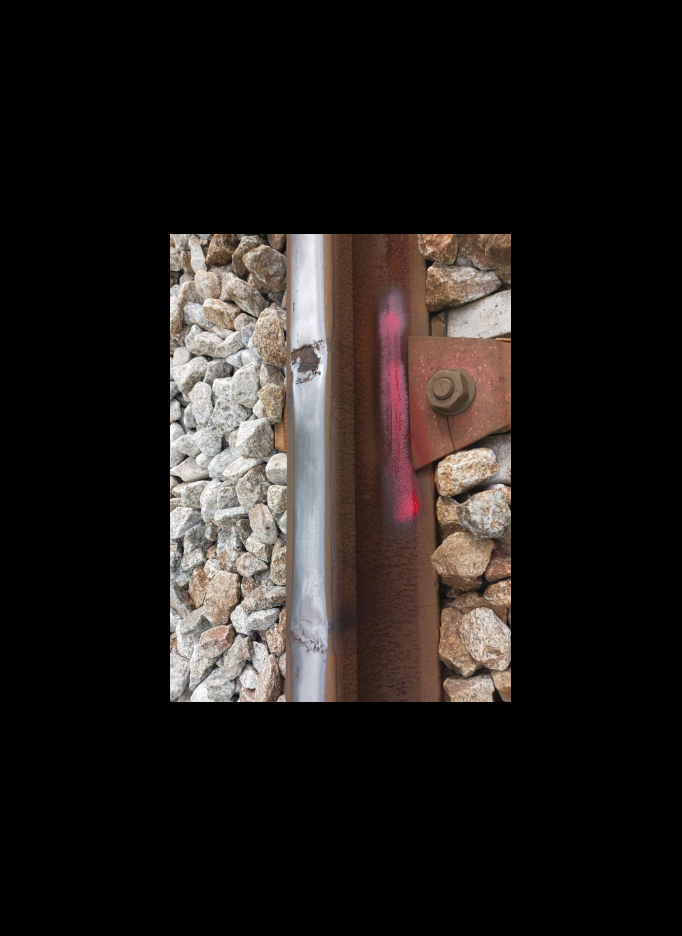

True

In [ ]:
from google.colab.patches import cv2_imshow  # Import this for displaying images in Colab

# Load an example image
image_path = '/content/drive/MyDrive/FotosDefeitos/017390_Cod472.jpg'  # Replace with your image path
image = cv2.imread(image_path)

# Zoom out the image
zoomed_out_image = zoom_out_image(image, scale=0.5)  # Zoom out by 50%

# Display the result
cv2_imshow(zoomed_out_image)  # Use cv2_imshow instead of cv2.imshow in Colab

# Save the zoomed-out image if needed
cv2.imwrite('/content/drive/MyDrive/FotosDefeitos/017390_Cod472zoomed_out_image.jpg', zoomed_out_image)


Image loaded successfully: /content/drive/MyDrive/FotosDefeitos/017390_Cod472.jpg

0: 640x480 (no detections), 245.6ms
Speed: 6.9ms preprocess, 245.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


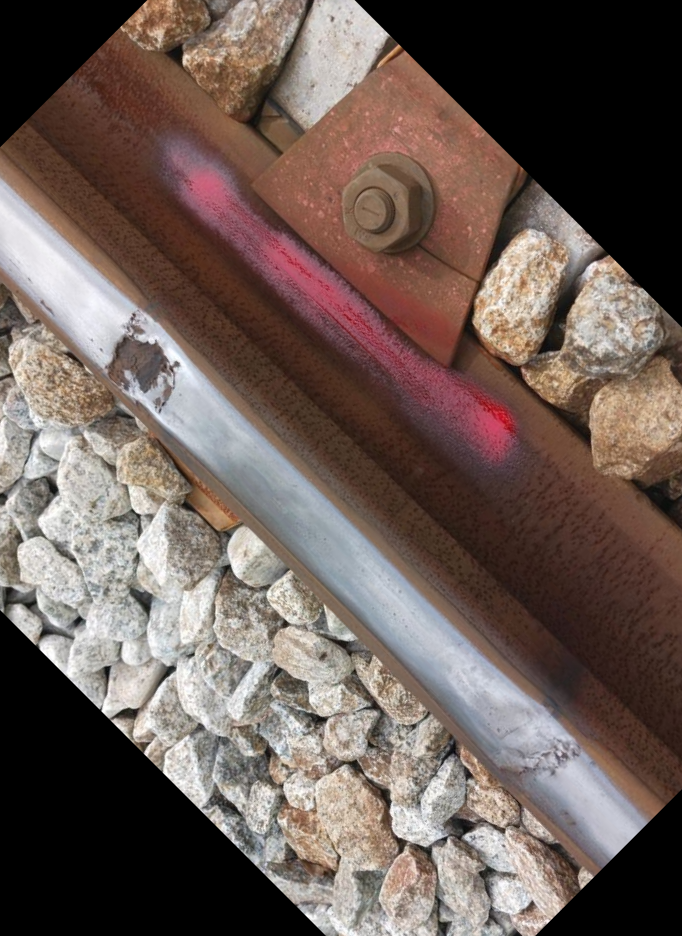

No rails detected in /content/drive/MyDrive/FotosDefeitos/017390_Cod472.jpg.
Cropping and saving of rail areas completed!


In [ ]:
import cv2
import os
from ultralytics import YOLO

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to the trained weights

# Path to the input image
input_image_path = '/content/drive/MyDrive/FotosDefeitos/017390_Cod472.jpg'  # Replace with the path to your image

# Path to save cropped rail areas
output_path = '/content/drive/MyDrive/FotosDefeitos/Cropped_Rail_Areas/'  # Folder to save cropped rail areas
os.makedirs(output_path, exist_ok=True)

# Path to save detection visualizations
visualization_path = '/content/drive/MyDrive/FotosDefeitos/Detection_Visualizations/'
os.makedirs(visualization_path, exist_ok=True)

# Load the image
img = cv2.imread(input_image_path)

# Check if the image is loaded successfully
if img is None:
    print(f"Error: Failed to load image: {input_image_path}")
else:
    print(f"Image loaded successfully: {input_image_path}")

# Rotate the image by 45 degrees
center = (img.shape[1] // 2, img.shape[0] // 2)  # Get the center of the image
rotation_matrix = cv2.getRotationMatrix2D(center, 45, 1)  # Rotation matrix for 45 degrees
rotated_img = cv2.warpAffine(img, rotation_matrix, (img.shape[1], img.shape[0]))  # Rotate the image

# Perform inference with adjusted confidence threshold
results = model(rotated_img, conf=0.25)  # Lower threshold to 0.25 for more detections

# Visualize and save detections (if any)
for idx, result in enumerate(results):  # Iterate over the list of results
    result.show()  # Display detections on the image
    # Save visualizations to a specified path
    save_path = os.path.join(visualization_path, f"detection_{idx}.jpg")
    result.save(save_path)  # Save visualizations for review

# Check if any detections were made
if len(results[0].boxes) == 0:
    print(f"No rails detected in {input_image_path}.")
else:
    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers
        conf = float(results[0].boxes.conf[i])  # Confidence score

        # Print detection details for debugging
        print(f"Detection {i}: Bounding box {bbox}, Confidence: {conf}")

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {input_image_path}: {bbox}")
            continue

        # Crop the rail area
        cropped_img = rotated_img[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(os.path.basename(input_image_path))[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

    print(f"Processed {input_image_path} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")


Image loaded successfully: /content/drive/MyDrive/FotosDefeitos/17069_Cod211.jpg

0: 480x640 1 rail, 579.7ms
Speed: 5.5ms preprocess, 579.7ms inference, 3.0ms postprocess per image at shape (1, 3, 480, 640)


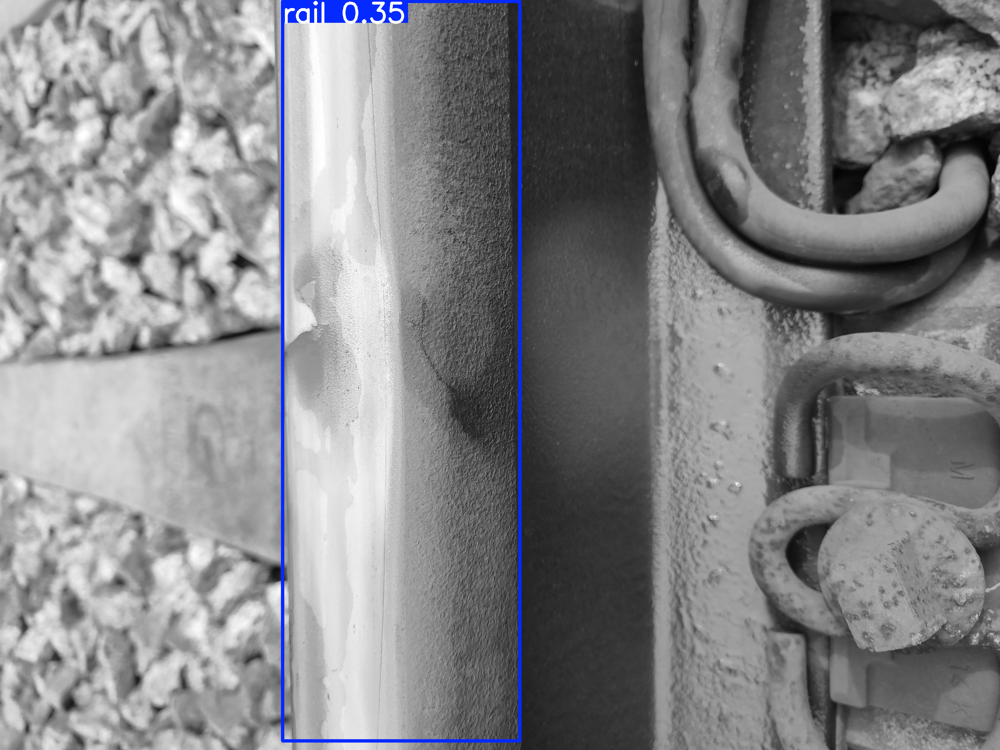

Detection 0: Bounding box tensor([1130.5413,    5.5895, 2079.9382, 2963.9846]), Confidence: 0.34623050689697266
Processed /content/drive/MyDrive/FotosDefeitos/17069_Cod211.jpg and saved cropped rail areas.
Cropping and saving of rail areas completed!


In [ ]:
import cv2
import os
from ultralytics import YOLO

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to the trained weights

# Path to the input image
input_image_path = '/content/drive/MyDrive/FotosDefeitos/17069_Cod211.jpg'  # Replace with the path to your image

# Path to save cropped rail areas
output_path = '/content/drive/MyDrive/FotosDefeitos/Cropped_Rail_Areas/'  # Folder to save cropped rail areas
os.makedirs(output_path, exist_ok=True)

# Path to save detection visualizations
visualization_path = '/content/drive/MyDrive/FotosDefeitos/Detection_Visualizations/'
os.makedirs(visualization_path, exist_ok=True)

# Load the image
img = cv2.imread(input_image_path)

# Check if the image is loaded successfully
if img is None:
    print(f"Error: Failed to load image: {input_image_path}")
else:
    print(f"Image loaded successfully: {input_image_path}")

# Convert the image to grayscale
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Convert grayscale image back to 3 channels by repeating the single channel
gray_img_3ch = cv2.cvtColor(gray_img, cv2.COLOR_GRAY2BGR)

# Perform inference with adjusted confidence threshold
results = model(gray_img_3ch, conf=0.25)  # Lower threshold to 0.25 for more detections

# Visualize and save detections (if any)
for idx, result in enumerate(results):  # Iterate over the list of results
    result.show()  # Display detections on the image
    # Save visualizations to a specified path
    save_path = os.path.join(visualization_path, f"detection_{idx}.jpg")
    result.save(save_path)  # Save visualizations for review

# Check if any detections were made
if len(results[0].boxes) == 0:
    print(f"No rails detected in {input_image_path}.")
else:
    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers
        conf = float(results[0].boxes.conf[i])  # Confidence score

        # Print detection details for debugging
        print(f"Detection {i}: Bounding box {bbox}, Confidence: {conf}")

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {input_image_path}: {bbox}")
            continue

        # Crop the rail area
        cropped_img = gray_img_3ch[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(os.path.basename(input_image_path))[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

    print(f"Processed {input_image_path} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")



0: 640x640 1 rail, 229.0ms
Speed: 2.9ms preprocess, 229.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


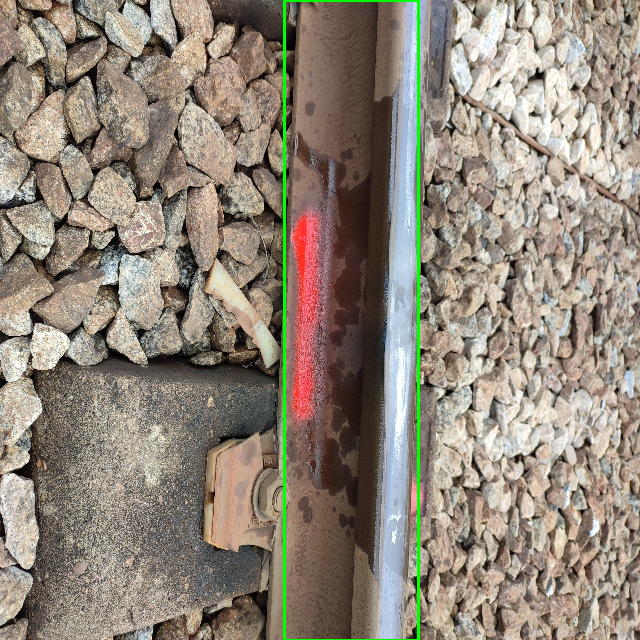

Processed 15422_Cod471.jpg and saved cropped rail areas.

0: 640x640 1 rail, 284.2ms
Speed: 3.0ms preprocess, 284.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


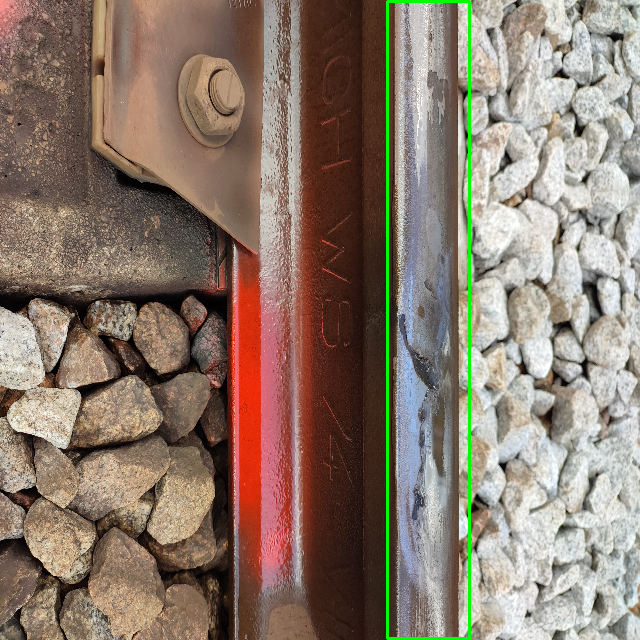

Processed 19567_Cod471.jpg and saved cropped rail areas.

0: 640x640 1 rail, 363.1ms
Speed: 3.1ms preprocess, 363.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


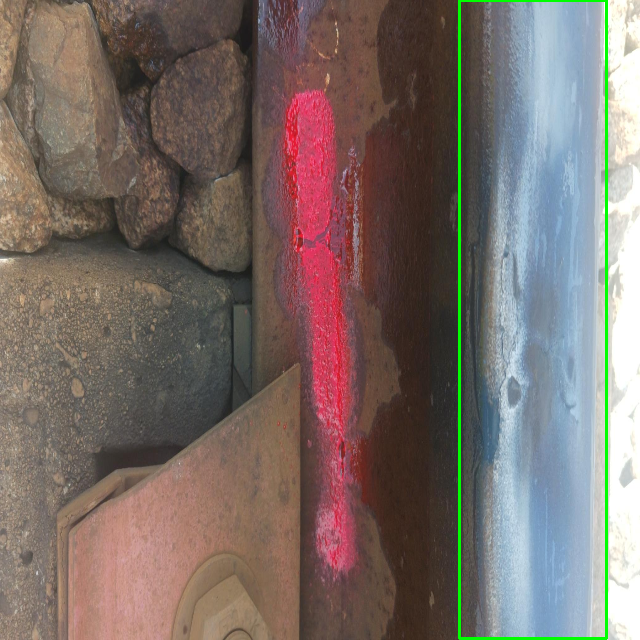

Processed 19973_Cod211.jpg and saved cropped rail areas.

0: 640x640 2 rails, 278.4ms
Speed: 3.5ms preprocess, 278.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


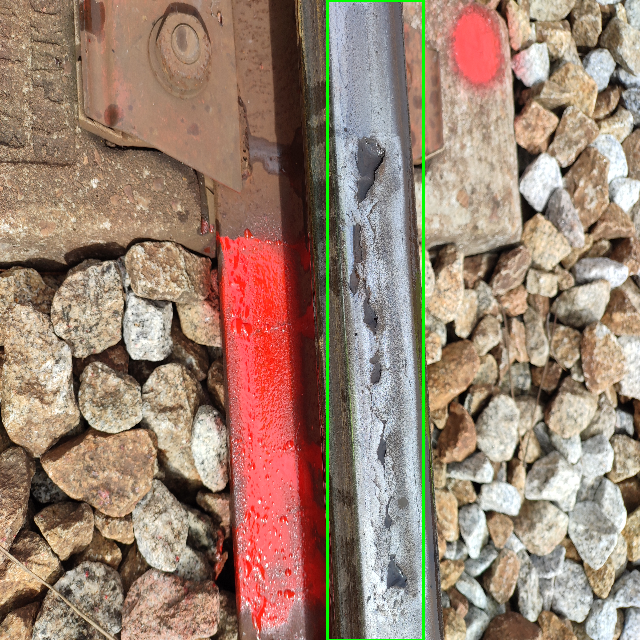

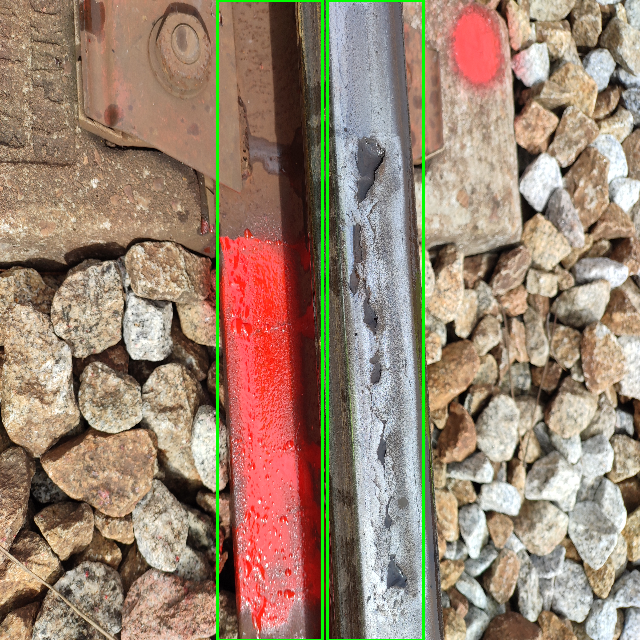

Processed 15180_Cod471.jpg and saved cropped rail areas.

0: 640x640 (no detections), 349.3ms
Speed: 3.2ms preprocess, 349.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
No rails detected in 17069_Cod211.jpg. Skipping.

0: 640x640 (no detections), 298.9ms
Speed: 3.6ms preprocess, 298.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
No rails detected in 17390_Cod472.jpg. Skipping.

0: 640x640 1 rail, 364.3ms
Speed: 3.1ms preprocess, 364.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


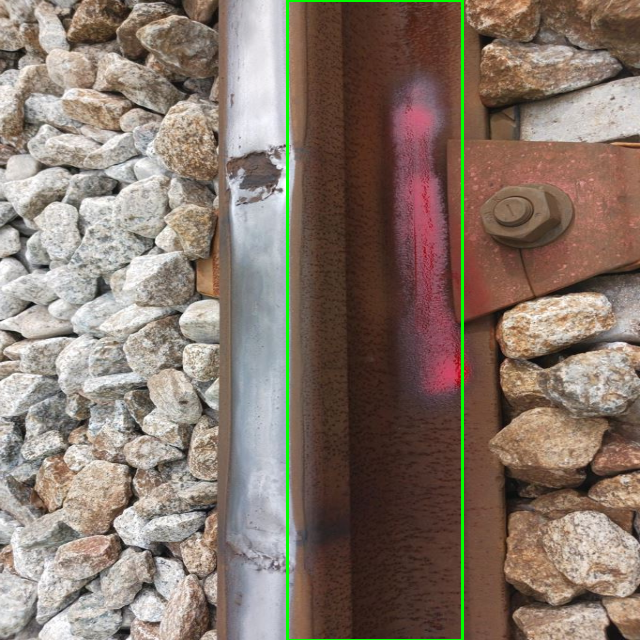

Processed 017390_Cod472.jpg and saved cropped rail areas.
Cropping and saving of rail areas completed!


In [ ]:
from ultralytics import YOLO
import cv2
import os
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to your trained model

# Define the new image database directory
input_images_path = "/content/drive/MyDrive/FotosDefeitos"  # Directory with new images
output_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails5"   # Directory to save cropped rail images
os.makedirs(output_path, exist_ok=True)

# List all images in the new images folder
image_files = [f for f in os.listdir(input_images_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Desired image size for YOLO model (should match the size used during training)
resize_width = 640
resize_height = 640

# Process each image
for img_file in image_files:
    # Load the image
    img_path = os.path.join(input_images_path, img_file)
    img = cv2.imread(img_path)

    # Resize the image to the desired size
    resized_img = cv2.resize(img, (resize_width, resize_height))  # Resize to 640x640 or your preferred size

    # Perform inference with adjusted confidence threshold
    results = model(resized_img, conf=0.25)  # Lower threshold to 0.25 for more detections

    # Check if any detections were made
    if len(results[0].boxes) == 0:
        print(f"No rails detected in {img_file}. Skipping.")
        continue

    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {img_file}: {bbox}")
            continue

        # Crop the rail area from the resized image
        cropped_img = resized_img[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(img_file)[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

        # Draw the bounding box on the original resized image
        cv2.rectangle(resized_img, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Draw green bounding box

        # Display the image with the bounding box using cv2_imshow for Colab
        cv2_imshow(resized_img)
        # No need for cv2.waitKey() in Colab

    print(f"Processed {img_file} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")


In [ ]:
from ultralytics import YOLO
import cv2
import os
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')  # Path to your trained model

# Define the new image database directory
input_images_path = "/content/drive/MyDrive/FotosDefeitos"  # Directory with new images
output_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"   # Directory to save cropped rail images
os.makedirs(output_path, exist_ok=True)

# List all images in the new images folder
image_files = [f for f in os.listdir(input_images_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Desired image size for YOLO model (should match the size used during training)
resize_width = 640
resize_height = 640

# Process each image
for img_file in image_files:
    # Load the image
    img_path = os.path.join(input_images_path, img_file)
    img = cv2.imread(img_path)

    # Convert the image to grayscale for preprocessing
    #gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply edge detection (Canny) to highlight edges
    edges = cv2.Canny(gray_img, 50, 150)  # You can adjust the thresholds (50, 150) for different results

    # Convert the single-channel edge image to 3 channels (BGR format)
    edges_colored = cv2.cvtColor(edges, cv2.COLOR_GRAY2BGR)

    # Resize the edge-detected image to the desired size
    #resized_img = cv2.resize(edges_colored, (resize_width, resize_height))  # Resize to 640x640 or your preferred size

    # Perform inference with adjusted confidence threshold
    #results = model(resized_img, conf=0.25)  # Lower threshold to 0.25 for more detections

    # Check if any detections were made
    #if len(results[0].boxes) == 0:
        #print(f"No rails detected in {img_file}. Skipping.")
       # continue

    # Log and process detected objects
    for i, bbox in enumerate(results[0].boxes.xyxy):  # Extract bounding boxes
        x1, y1, x2, y2 = map(int, bbox)  # Convert coordinates to integers

        # Validate bounding box
        if x1 >= x2 or y1 >= y2:  # Invalid bounding box
            print(f"Invalid bounding box in {img_file}: {bbox}")
            continue

        # Crop the rail area from the resized image
        cropped_img = resized_img[y1:y2, x1:x2]

        # Save the cropped image
        output_file = os.path.join(output_path, f"{os.path.splitext(img_file)[0]}_crop{i}.jpg")
        cv2.imwrite(output_file, cropped_img)

        # Draw the bounding box on the original resized image
        cv2.rectangle(resized_img, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Draw green bounding box

        # Display the image with the bounding box using cv2_imshow for Colab
        cv2_imshow(resized_img)
        # No need for cv2.waitKey() in Colab

    print(f"Processed {img_file} and saved cropped rail areas.")

print("Cropping and saving of rail areas completed!")


Processed 15422_Cod471.jpg and saved cropped rail areas.
Processed 19567_Cod471.jpg and saved cropped rail areas.
Processed 19973_Cod211.jpg and saved cropped rail areas.
Processed 15180_Cod471.jpg and saved cropped rail areas.
Processed 17069_Cod211.jpg and saved cropped rail areas.
Processed 17390_Cod472.jpg and saved cropped rail areas.
Processed 017390_Cod472.jpg and saved cropped rail areas.
Cropping and saving of rail areas completed!


#Classification

In [ ]:
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load the Vision Transformer model from Hugging Face
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)  # Update num_labels
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")
        return inputs, img_path

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False)

# Run inference
results = []
with torch.no_grad():
    for batch in data_loader:
        inputs, paths = batch
        inputs = {k: v.squeeze(0).to(device) for k, v in inputs.items()}
        outputs = model(**inputs)
        preds = torch.argmax(outputs.logits, dim=1)
        results.extend(zip(paths, preds.cpu().numpy()))

# Display or save results
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


ValueError: too many values to unpack (expected 4)

In [ ]:
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")  # Returns a dict
        return inputs["pixel_values"].squeeze(0), img_path  # Extract tensor and path

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False)

# Run inference
results = []
with torch.no_grad():
    for batch in data_loader:
        images, paths = batch
        images = images.to(device)
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)
        results.extend(zip(paths, preds.cpu().numpy()))

# Save results
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results.txt


In [ ]:
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")  # Returns a dict
        return inputs["pixel_values"].squeeze(0), img_path  # Extract tensor and path

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False)

# Run inference
results = []
with torch.no_grad():
    for batch in data_loader:
        images, paths = batch
        images = images.to(device)
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)
        # Map numerical predictions to class names
        pred_classes = [class_names[pred] for pred in preds.cpu().numpy()]
        results.extend(zip(paths, pred_classes))

# Save results
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results.txt"
with open(output_file, "w") as f:
    for path, pred_class in results:
        f.write(f"{path} -> Predicted Class: {pred_class}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results.txt


In [ ]:
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")  # Returns a dict
        return inputs["pixel_values"].squeeze(0), img_path  # Extract tensor and path

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False)

# Run inference
results = []
with torch.no_grad():
    for batch in data_loader:
        images, paths = batch
        images = images.to(device)
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)
        results.extend(zip(paths, [class_names[pred] for pred in preds.cpu().numpy()]))

# Save results
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results1.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results1.txt


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


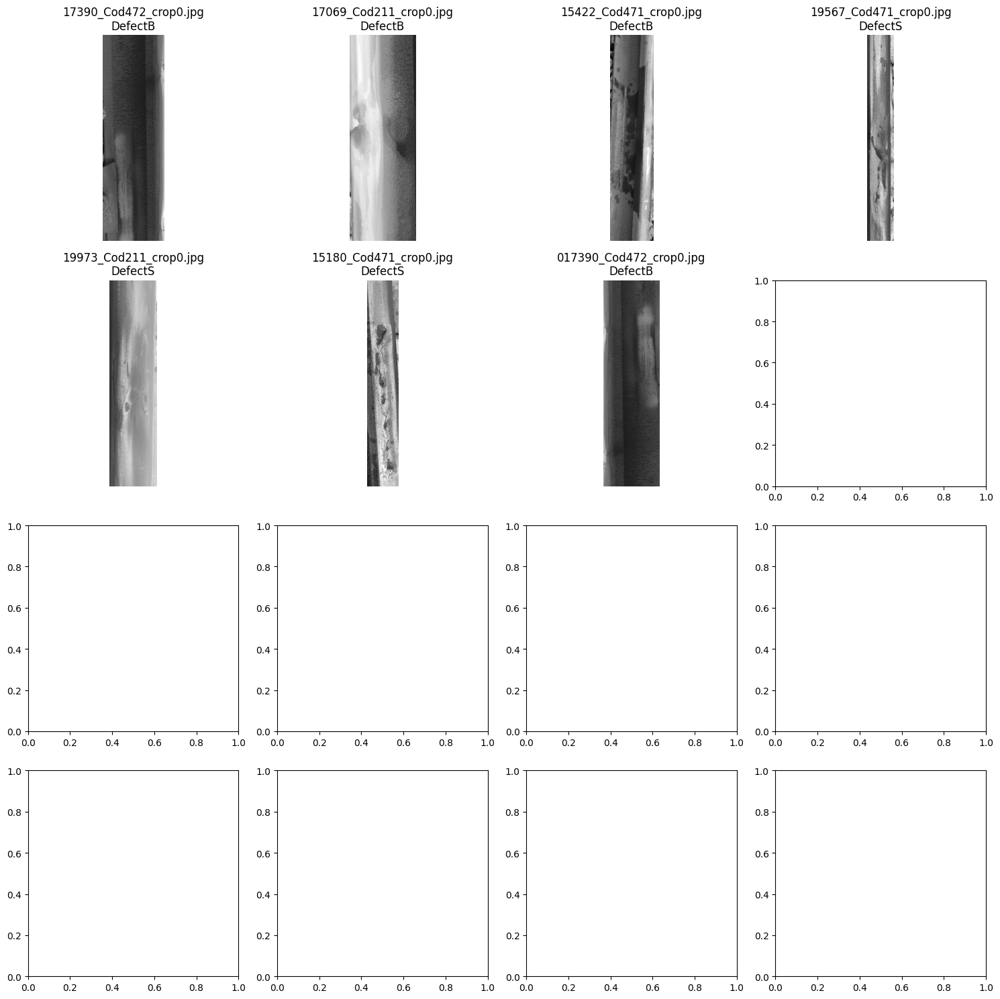

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results2.txt


In [ ]:
import matplotlib.pyplot as plt
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")  # Returns a dict
        return inputs["pixel_values"].squeeze(0), img_path, img  # Return image as well

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Run inference and display images with their predicted classes
results = []
fig, axes = plt.subplots(4, 4, figsize=(15, 15))  # Adjust the number of rows and columns
axes = axes.flatten()  # Flatten to easily index

with torch.no_grad():
    for batch_idx, batch in enumerate(data_loader):
        images, paths, original_images = batch
        images = torch.stack([img.to(device) for img in images])  # Stack images into a tensor
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)

        # Display the images and their predicted classes
        for i, (img, pred, path) in enumerate(zip(original_images, preds, paths)):
            # Map prediction to class name
            class_name = class_names[pred.item()]

            # Display image
            axes[batch_idx * 7 + i].imshow(img)
            axes[batch_idx * 7 + i].set_title(f"{os.path.basename(path)}\n{class_name}")
            axes[batch_idx * 7 + i].axis('off')  # Hide axis

        if batch_idx * 7 + i >= len(axes):
            break  # Stop if we run out of axes

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results2.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


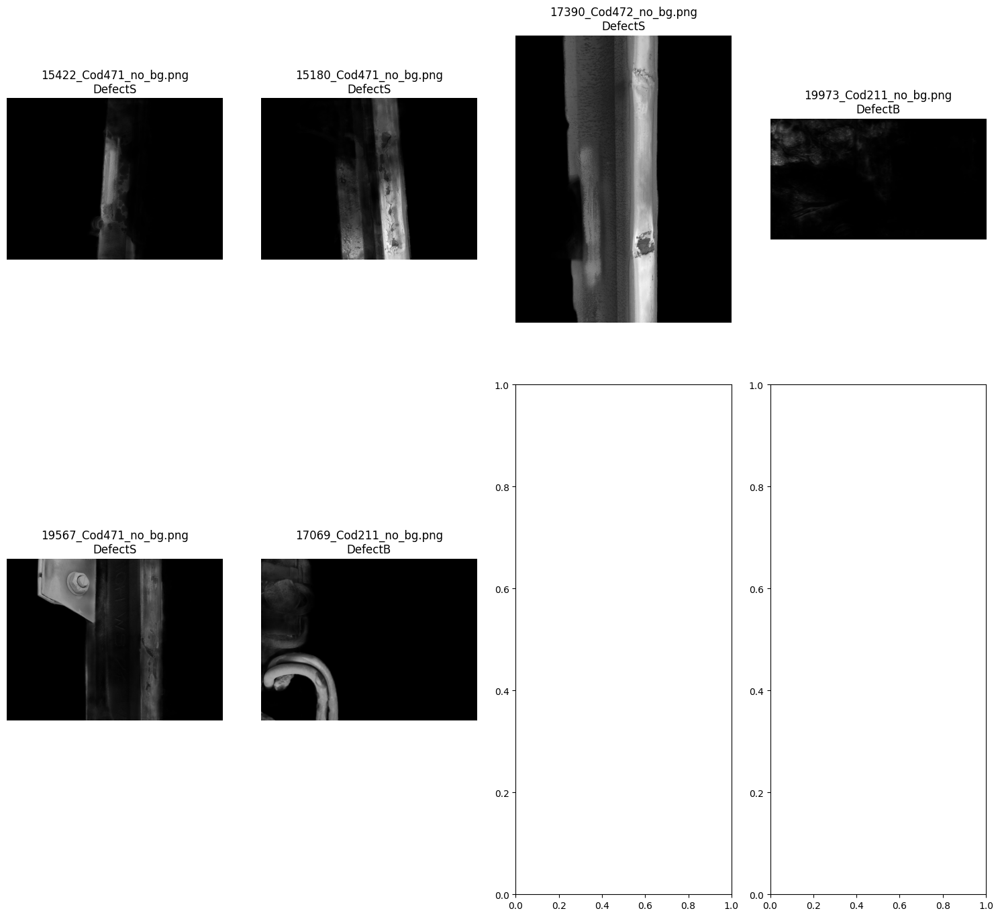

Classification results saved to /content/drive/MyDrive/FotosDefeitos_output-u2net-raw/classification_results2.txt


In [ ]:
import matplotlib.pyplot as plt
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos_output-u2net-raw"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")  # Returns a dict
        return inputs["pixel_values"].squeeze(0), img_path, img  # Return image as well

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Run inference and display images with their predicted classes
results = []
fig, axes = plt.subplots(2, 4, figsize=(15, 15))  # Adjust the number of rows and columns
axes = axes.flatten()  # Flatten to easily index

with torch.no_grad():
    for batch_idx, batch in enumerate(data_loader):
        images, paths, original_images = batch
        images = torch.stack([img.to(device) for img in images])  # Stack images into a tensor
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)

        # Display the images and their predicted classes
        for i, (img, pred, path) in enumerate(zip(original_images, preds, paths)):
            # Map prediction to class name
            class_name = class_names[pred.item()]

            # Display image
            axes[batch_idx * 7 + i].imshow(img)
            axes[batch_idx * 7 + i].set_title(f"{os.path.basename(path)}\n{class_name}")
            axes[batch_idx * 7 + i].axis('off')  # Hide axis

        if batch_idx * 7 + i >= len(axes):
            break  # Stop if we run out of axes

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos_output-u2net-raw/classification_results2.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


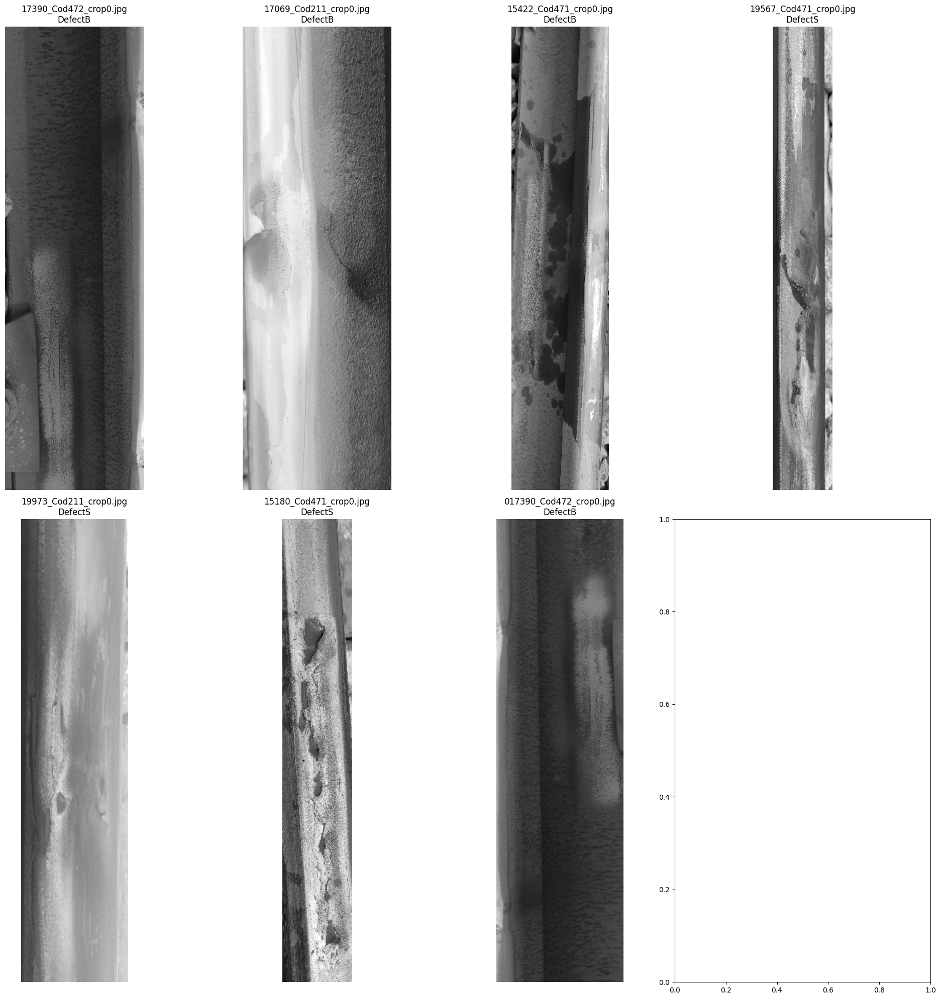

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results2.txt


In [ ]:
import matplotlib.pyplot as plt
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Grayscale Images
class GrayscaleImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("L")  # Convert to grayscale
        img = img.convert("RGB")  # Convert back to RGB for ViT input
        inputs = self.processor(images=img, return_tensors="pt")  # Returns a dict
        return inputs["pixel_values"].squeeze(0), img_path, img  # Return image as well

dataset = GrayscaleImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Run inference and display images with their predicted classes
results = []
fig, axes = plt.subplots(2, 4, figsize=(20, 20))  # Adjust the number of rows and columns
axes = axes.flatten()  # Flatten to easily index

with torch.no_grad():
    for batch_idx, batch in enumerate(data_loader):
        images, paths, original_images = batch
        images = torch.stack([img.to(device) for img in images])  # Stack images into a tensor
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)

        # Display the images and their predicted classes
        for i, (img, pred, path) in enumerate(zip(original_images, preds, paths)):
            # Map prediction to class name
            class_name = class_names[pred.item()]

            # Display image
            axes[i].imshow(img)
            axes[i].set_title(f"{os.path.basename(path)}\n{class_name}")
            axes[i].axis('off')  # Hide axis

            # Save result for later (optional)
            results.append((path, class_name))

        if batch_idx * 16 + i >= len(axes):
            break  # Stop if we run out of axes

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results2.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


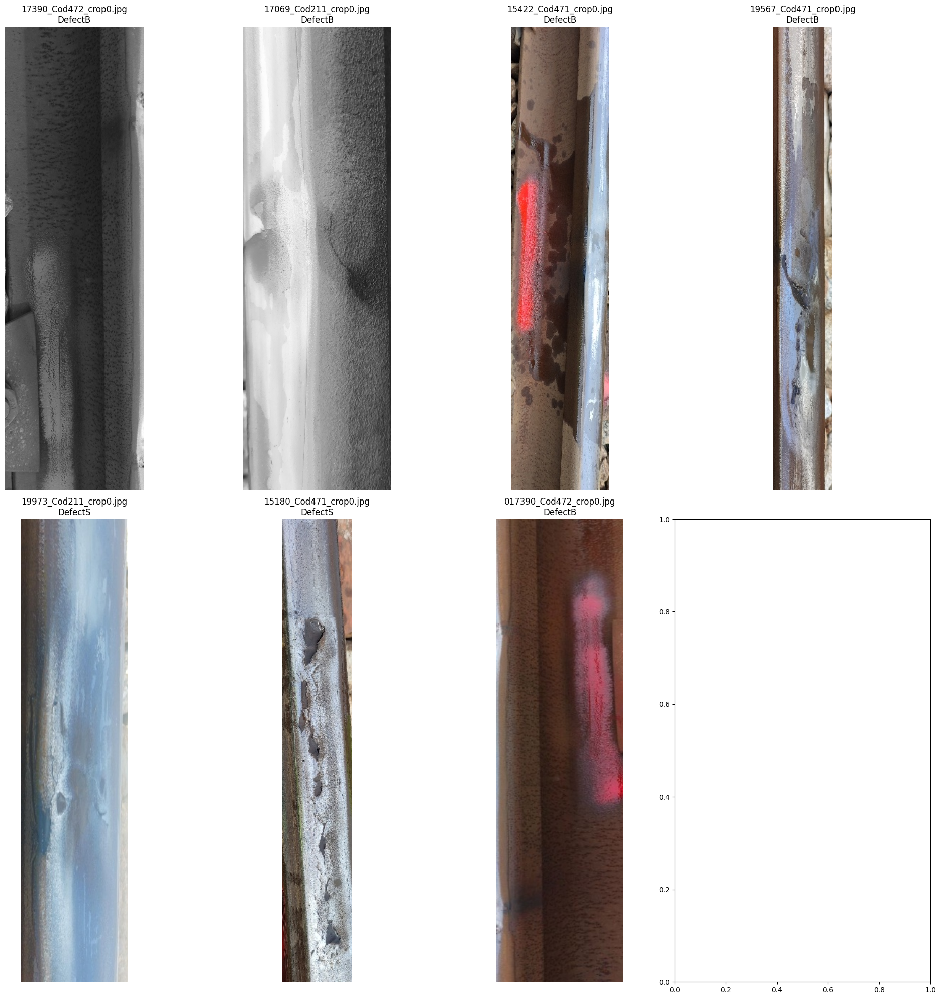

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results2.txt


In [ ]:
import matplotlib.pyplot as plt
from transformers import ViTForImageClassification, ViTImageProcessor
import torch
from PIL import Image
import os
from torch.utils.data import DataLoader, Dataset

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/vit_model.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the Vision Transformer model with 5 classes
model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224-in21k", num_labels=5)
model.load_state_dict(torch.load(saved_model_path, map_location=device))
model = model.to(device)
model.eval()

# Preprocessing using Hugging Face ViT Image Processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")

# Custom Dataset for Original Images
class OriginalImageDataset(Dataset):
    def __init__(self, image_folder, processor):
        self.image_folder = image_folder
        self.processor = processor
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("RGB")  # Load original image in RGB format
        inputs = self.processor(images=img, return_tensors="pt")  # Preprocess for ViT
        return inputs["pixel_values"].squeeze(0), img_path, img  # Return image as well

dataset = OriginalImageDataset(cropped_database_path, processor)
data_loader = DataLoader(dataset, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

# Run inference and display images with their predicted classes
results = []
fig, axes = plt.subplots(2, 4, figsize=(20, 20))  # Adjust the number of rows and columns for 8 images
axes = axes.flatten()  # Flatten to easily index

with torch.no_grad():
    for batch_idx, batch in enumerate(data_loader):
        images, paths, original_images = batch
        images = torch.stack([img.to(device) for img in images])  # Stack images into a tensor
        outputs = model(pixel_values=images)  # Pass images as 'pixel_values'
        preds = torch.argmax(outputs.logits, dim=1)

        # Display the images and their predicted classes
        for i, (img, pred, path) in enumerate(zip(original_images, preds, paths)):
            # Map prediction to class name
            class_name = class_names[pred.item()]

            # Display image
            axes[i].imshow(img)
            axes[i].set_title(f"{os.path.basename(path)}\n{class_name}")
            axes[i].axis('off')  # Hide axis

            # Save result for later (optional)
            results.append((path, class_name))

        if batch_idx * 8 + i >= len(axes):
            break  # Stop if we run out of axes

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results2.txt"
with open(output_file, "w") as f:
    for path, pred in results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


#Resnet 50

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


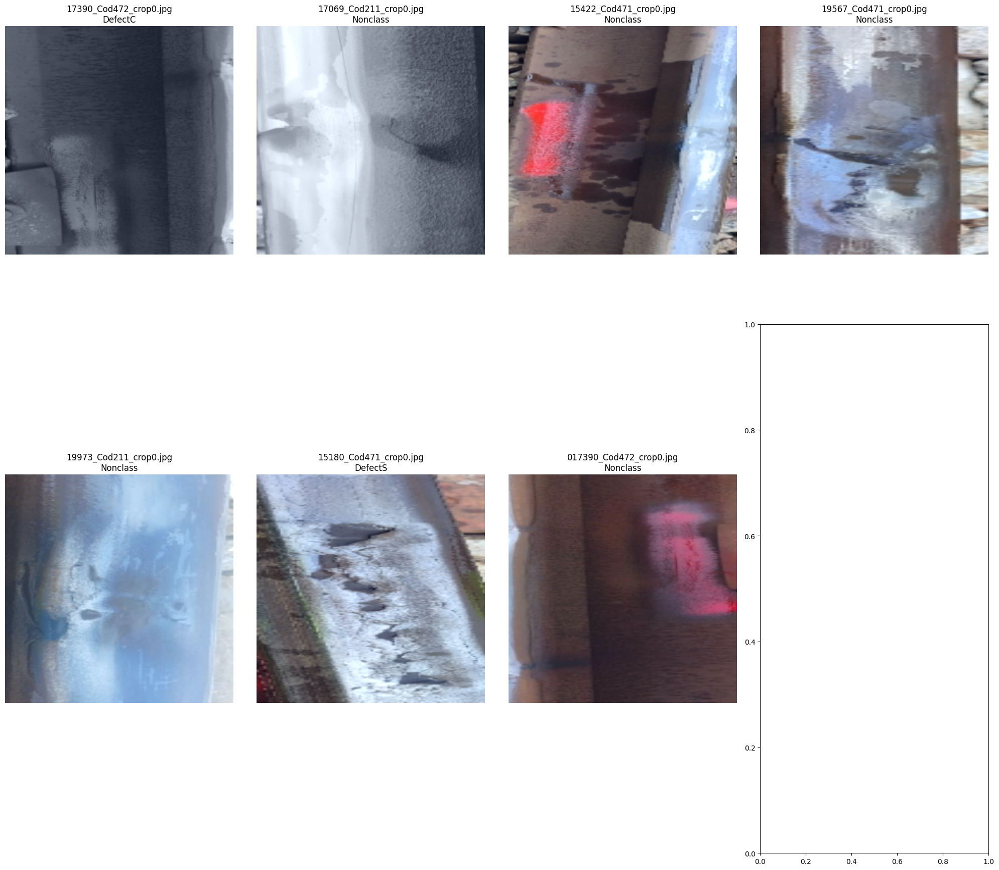

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results_resnet50.txt


In [ ]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from PIL import Image
import os

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/ResNet50.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "NonDefect"]

# Load the ResNet50 model
resnet50_model = models.resnet50(pretrained=True)
resnet50_model.fc = torch.nn.Linear(resnet50_model.fc.in_features, len(class_names))  # Adjust for 5 classes
resnet50_model.load_state_dict(torch.load(saved_model_path, map_location=device))
resnet50_model = resnet50_model.to(device)
resnet50_model.eval()

# Define the preprocessing pipeline for ResNet
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to fit ResNet input
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

# Custom Dataset for Preprocessing
class PreprocessedImageDataset(Dataset):
    def __init__(self, image_folder, transform):
        self.image_folder = image_folder
        self.transform = transform
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("RGB")  # Ensure images are RGB
        img = self.transform(img)  # Apply transformations
        return img, img_path

dataset = PreprocessedImageDataset(cropped_database_path, transform)
data_loader = DataLoader(dataset, batch_size=8, shuffle=False)

# Function to classify and display images
def classify_and_display(model, data_loader, class_names, axes):
    results = []
    with torch.no_grad():
        for batch_idx, (images, paths) in enumerate(data_loader):
            images = images.to(device)  # Move images to device
            outputs = model(images)  # Forward pass through the model
            _, preds = torch.max(outputs, 1)  # Get the predicted classes

            # Display images with their predicted classes
            for i, (img, pred, path) in enumerate(zip(images, preds, paths)):
                class_name = class_names[pred.item()]  # Map prediction to class name
                ax = axes[i]

                # Convert the image tensor to numpy for display
                img = img.cpu().numpy().transpose((1, 2, 0))  # Convert from (C, H, W) to (H, W, C)
                img = img * 0.229 + 0.485  # Unnormalize (use mean and std values)
                img = np.clip(img, 0, 1)  # Ensure values are in the range [0, 1]

                ax.imshow(img)  # Display the image
                ax.set_title(f"{os.path.basename(path)}\n{class_name}")
                ax.axis('off')
                results.append((path, class_name))  # Store result

    return results

# Plotting and displaying images
fig, axes = plt.subplots(2, 4, figsize=(20, 20))  # Adjust for 8 images
axes = axes.flatten()

resnet50_results = classify_and_display(resnet50_model, data_loader, class_names, axes)

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results_resnet50.txt"
with open(output_file, "w") as f:
    for path, pred in resnet50_results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 56.1MB/s]


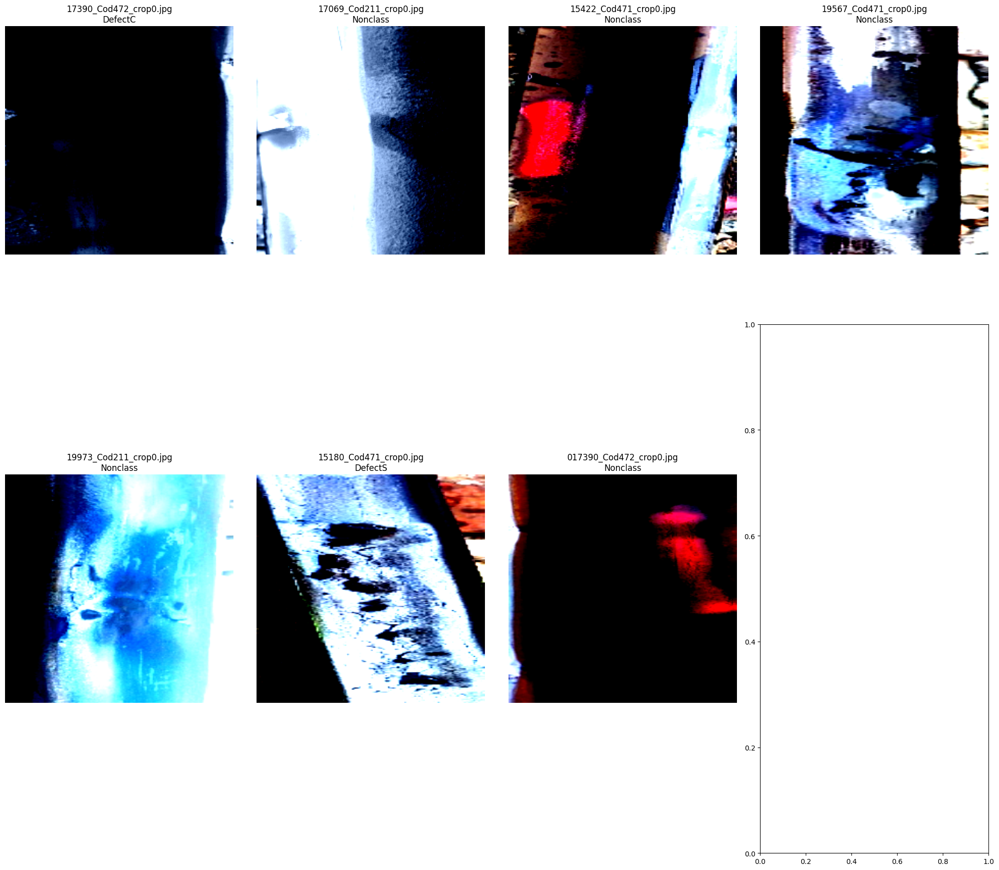

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results_resnet50.txt


In [ ]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from PIL import Image
import os

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/ResNet50.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the ResNet50 model
resnet50_model = models.resnet50(pretrained=True)
resnet50_model.fc = torch.nn.Linear(resnet50_model.fc.in_features, len(class_names))  # Adjust for 5 classes
resnet50_model.load_state_dict(torch.load(saved_model_path, map_location=device))
resnet50_model = resnet50_model.to(device)
resnet50_model.eval()

# Define the preprocessing pipeline for ResNet
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to fit ResNet input
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

# Custom Dataset for Preprocessing
class PreprocessedImageDataset(Dataset):
    def __init__(self, image_folder, transform):
        self.image_folder = image_folder
        self.transform = transform
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("RGB")  # Ensure images are RGB
        img = self.transform(img)  # Apply transformations
        return img, img_path

dataset = PreprocessedImageDataset(cropped_database_path, transform)
data_loader = DataLoader(dataset, batch_size=8, shuffle=False)

# Function to classify and display images
def classify_and_display(model, data_loader, class_names, axes):
    results = []
    with torch.no_grad():
        for batch_idx, (images, paths) in enumerate(data_loader):
            images = images.to(device)  # Move images to device
            outputs = model(images)  # Forward pass through the model
            _, preds = torch.max(outputs, 1)  # Get the predicted classes

            # Display images with their predicted classes
            for i, (img, pred, path) in enumerate(zip(images, preds, paths)):
                class_name = class_names[pred.item()]  # Map prediction to class name
                ax = axes[i]
                ax.imshow(img.permute(1, 2, 0).cpu())  # Convert tensor back to image format
                ax.set_title(f"{os.path.basename(path)}\n{class_name}")
                ax.axis('off')
                results.append((path, class_name))  # Store result

    return results

# Plotting and displaying images
fig, axes = plt.subplots(2, 4, figsize=(20, 20))  # Adjust for 8 images
axes = axes.flatten()

resnet50_results = classify_and_display(resnet50_model, data_loader, class_names, axes)

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results_resnet50.txt"
with open(output_file, "w") as f:
    for path, pred in resnet50_results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


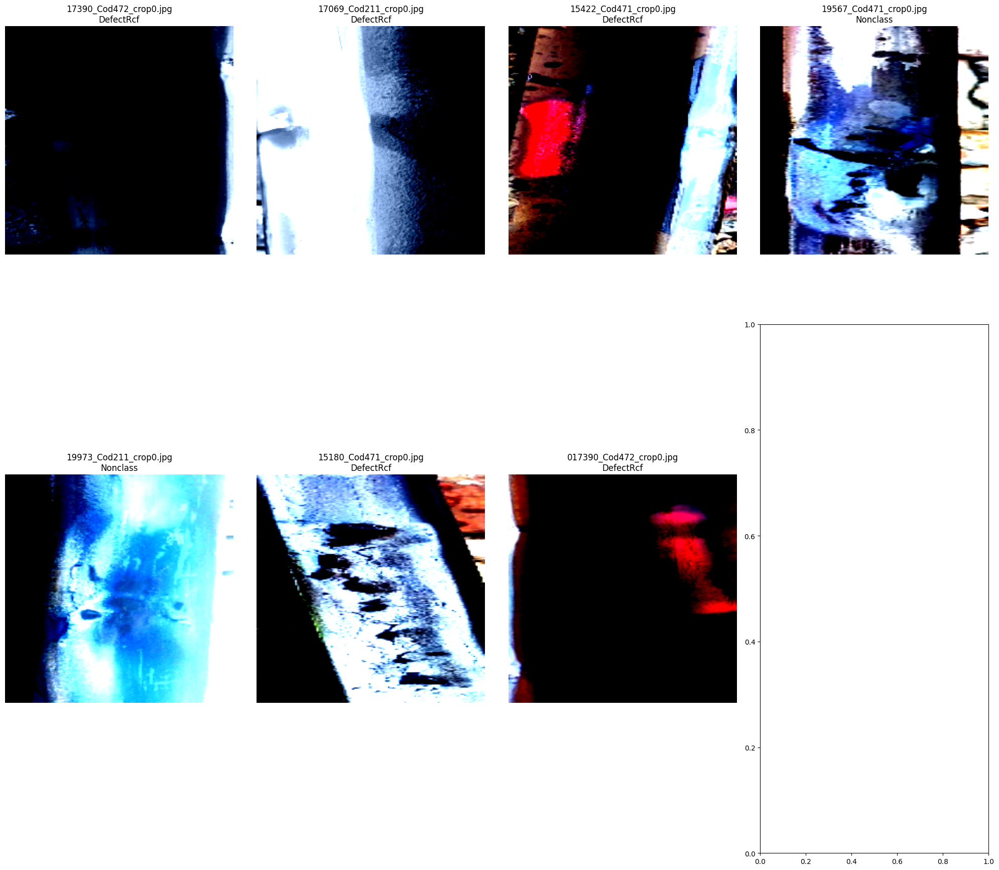

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results_resnet18.txt


In [ ]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from PIL import Image
import os

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/ResNet18.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load ResNet18 model
resnet18_model = models.resnet18(pretrained=False, num_classes=5)
resnet18_model.load_state_dict(torch.load(resnet18_model_path, map_location=device))
resnet18_model = resnet18_model.to(device)
resnet18_model.eval()

# Define the preprocessing pipeline for ResNet
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to fit ResNet input
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

# Custom Dataset for Preprocessing
class PreprocessedImageDataset(Dataset):
    def __init__(self, image_folder, transform):
        self.image_folder = image_folder
        self.transform = transform
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("RGB")  # Ensure images are RGB
        img = self.transform(img)  # Apply transformations
        return img, img_path

dataset = PreprocessedImageDataset(cropped_database_path, transform)
data_loader = DataLoader(dataset, batch_size=8, shuffle=False)

# Function to classify and display images
def classify_and_display(model, data_loader, class_names, axes):
    results = []
    with torch.no_grad():
        for batch_idx, (images, paths) in enumerate(data_loader):
            images = images.to(device)  # Move images to device
            outputs = model(images)  # Forward pass through the model
            _, preds = torch.max(outputs, 1)  # Get the predicted classes

            # Display images with their predicted classes
            for i, (img, pred, path) in enumerate(zip(images, preds, paths)):
                class_name = class_names[pred.item()]  # Map prediction to class name
                ax = axes[i]
                ax.imshow(img.permute(1, 2, 0).cpu())  # Convert tensor back to image format
                ax.set_title(f"{os.path.basename(path)}\n{class_name}")
                ax.axis('off')
                results.append((path, class_name))  # Store result

    return results

# Plotting and displaying images
fig, axes = plt.subplots(2, 4, figsize=(20, 20))  # Adjust for 8 images
axes = axes.flatten()

resnet50_results = classify_and_display(resnet50_model, data_loader, class_names, axes)

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results_resnet18.txt"
with open(output_file, "w") as f:
    for path, pred in resnet50_results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


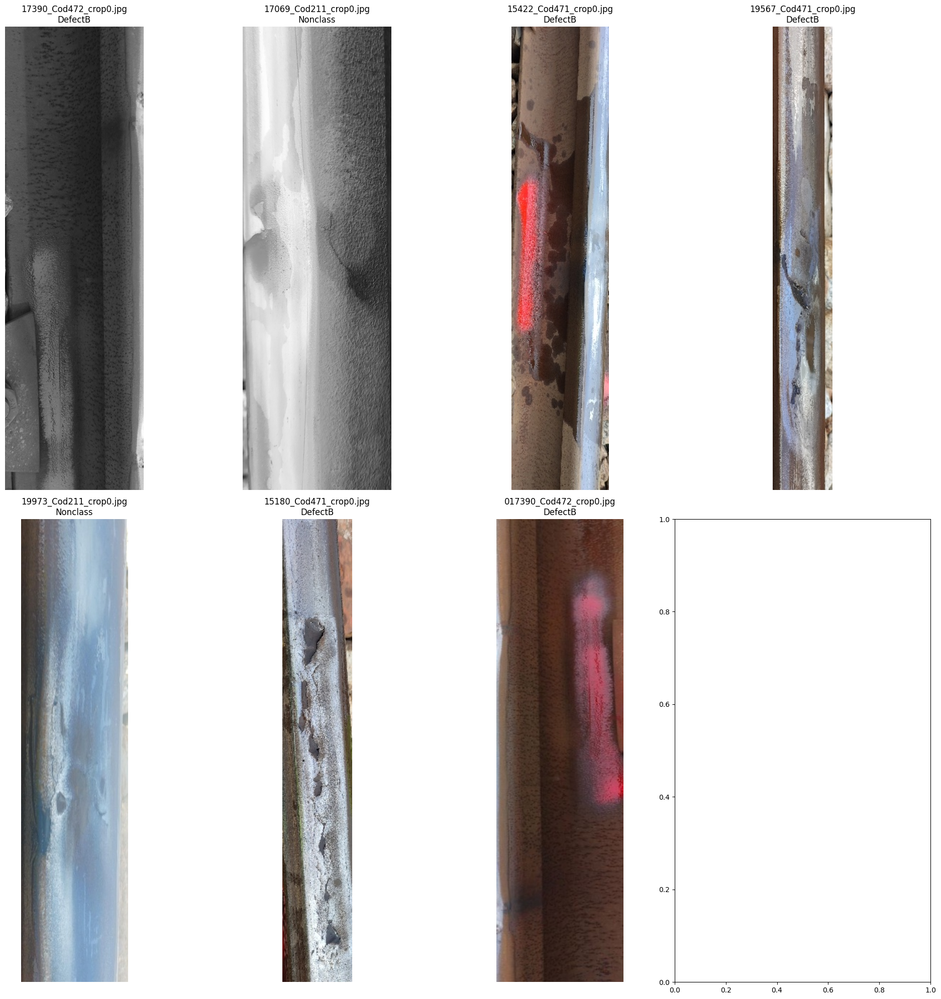

Classification results saved to /content/drive/MyDrive/FotosDefeitos/classification_results_resnet18.txt


In [ ]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from PIL import Image
import os

# Define paths
cropped_database_path = "/content/drive/MyDrive/FotosDefeitos/CroppedRails6"
saved_model_path = "/content/drive/MyDrive/Save model/resnet18.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define class names
class_names = ["DefectB", "DefectC", "DefectRcf", "DefectS", "Nonclass"]

# Load the ResNet18 model
resnet18_model = models.resnet18(pretrained=True)
resnet18_model.fc = torch.nn.Linear(resnet18_model.fc.in_features, len(class_names))  # Adjust for 5 classes
resnet18_model.load_state_dict(torch.load(saved_model_path, map_location=device))
resnet18_model = resnet18_model.to(device)
resnet18_model.eval()

# Define the preprocessing pipeline for ResNet
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to fit ResNet input
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

# Custom Dataset for Preprocessing
class PreprocessedImageDataset(Dataset):
    def __init__(self, image_folder, transform):
        self.image_folder = image_folder
        self.transform = transform
        self.image_paths = [
            os.path.join(image_folder, img)
            for img in os.listdir(image_folder)
            if img.endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("RGB")
        preprocessed_img = self.transform(img)  # Apply preprocessing
        return preprocessed_img, img_path, img  # Include original PIL image for display

# Custom collate function
def custom_collate_fn(batch):
    """
    Custom collate function to separate tensors, paths, and original images.
    """
    images = torch.stack([item[0] for item in batch])  # Batch of tensors
    paths = [item[1] for item in batch]  # File paths
    original_images = [item[2] for item in batch]  # Original PIL images
    return images, paths, original_images

dataset = PreprocessedImageDataset(cropped_database_path, transform)
data_loader = DataLoader(dataset, batch_size=16, shuffle=False, collate_fn=custom_collate_fn)

# Function to classify and display images
def classify_and_display(model, data_loader, class_names, axes):
    results = []
    with torch.no_grad():
        for batch_idx, (images, paths, original_images) in enumerate(data_loader):
            images = images.to(device)
            outputs = model(images)
            preds = torch.argmax(outputs, dim=1)

            # Display the images and their predicted classes
            for i, (img, pred, path) in enumerate(zip(original_images, preds, paths)):
                class_name = class_names[pred.item()]

                # Display image
                axes[i].imshow(img)
                axes[i].set_title(f"{os.path.basename(path)}\n{class_name}")
                axes[i].axis('off')

                # Save result for later
                results.append((path, class_name))

    return results

# Display results for ResNet18
fig, axes = plt.subplots(2, 4, figsize=(20, 20))  # Adjust for 8 images
axes = axes.flatten()  # Flatten to easily index
resnet18_results = classify_and_display(resnet18_model, data_loader, class_names, axes)

plt.tight_layout()
plt.show()

# Optionally, save results to a text file
output_file = "/content/drive/MyDrive/FotosDefeitos/classification_results_resnet18.txt"
with open(output_file, "w") as f:
    for path, pred in resnet18_results:
        f.write(f"{path} -> Predicted Class: {pred}\n")

print(f"Classification results saved to {output_file}")


#Crop Detected Faults Using YOLO Outputs

In [ ]:
import cv2
import os

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')

# Path to images
image_folder = '/content/drive/MyDrive/Defect'
output_folder = '/content/drive/MyDrive/Defect/ROIs'

os.makedirs(output_folder, exist_ok=True)

# Iterate through images and extract ROIs
for img_name in os.listdir(image_folder):
    img_path = os.path.join(image_folder, img_name)
    results = model(img_path)

    # Iterate through detections and save cropped ROIs
    for i, detection in enumerate(results[0].boxes.xyxy):
        x1, y1, x2, y2 = map(int, detection)
        img = cv2.imread(img_path)
        roi = img[y1:y2, x1:x2]
        roi_name = f"{os.path.splitext(img_name)[0]}_roi_{i}.jpg"
        cv2.imwrite(os.path.join(output_folder, roi_name), roi)



image 1/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10038.JPEG: 384x640 1 rail, 38.1ms
image 2/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10039.JPEG: 384x640 1 rail, 7.0ms
image 3/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10040.JPEG: 384x640 1 rail, 6.9ms
image 4/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10041.JPEG: 384x640 1 rail, 7.0ms
image 5/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10042.JPEG: 384x640 1 rail, 9.5ms
image 6/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10043.JPEG: 384x640 1 rail, 8.9ms
image 7/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10044.JPEG: 384x640 1 rail, 10.2ms
image 8/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10045.JPEG: 384x640 1 rail, 10.0ms
image 9/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_20201228114152_10046.JPEG: 384x640 1 rail, 12.0ms
image 10/40 /content/drive/MyDrive/Defect/Cracks/C.MOV_2020122811415

TypeError: 'NoneType' object is not subscriptable

In [ ]:
import os
import cv2
from ultralytics import YOLO
from PIL import Image
import numpy as np
import logging

# Configure Logging
logging.basicConfig(level=logging.INFO)

# Load YOLO Model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results1/rail_defects3/weights/best.pt')

# Paths
input_folder = "/content/drive/MyDrive/Defect"
output_folder = "/content/drive/MyDrive/CroppedFaults1"
os.makedirs(output_folder, exist_ok=True)

# Supported Extensions
supported_extensions = {'.jpg', '.jpeg', '.png'}

# Process Images
for img_file in os.listdir(input_folder):
    if not os.path.splitext(img_file)[1].lower() in supported_extensions:
        continue

    img_path = os.path.join(input_folder, img_file)
    try:
        image = cv2.imread(img_path)
        if image is None:  # Handle failed reads
            logging.warning(f"cv2 failed to load {img_path}. Trying Pillow.")
            image = Image.open(img_path).convert("RGB")
            image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    except Exception as e:
        logging.error(f"Error loading image {img_path}: {e}")
        continue

    results = model.predict(image, save=False, save_txt=False, conf=0.5)
    for i, box in enumerate(results[0].boxes.xyxy):
        x1, y1, x2, y2 = map(int, box)
        cropped = image[y1:y2, x1:x2]
        crop_path = os.path.join(output_folder, f"{os.path.splitext(img_file)[0]}_crop{i}.jpg")
        cv2.imwrite(crop_path, cropped)
        logging.info(f"Cropped image saved: {crop_path}")

logging.info("Cropping completed.")




In [ ]:
import cv2
from ultralytics import YOLO
import os
import logging

# Setup logging
logging.basicConfig(level=logging.INFO, format='%(levelname)s: %(message)s')

# Load trained YOLO model
model_path = '/content/drive/MyDrive/YOLOv8_Results/rail_defects/weights/best.pt'
if not os.path.exists(model_path):
    logging.error(f"YOLO model not found at {model_path}")
    raise FileNotFoundError(f"YOLO model not found at {model_path}")

model = YOLO(model_path)

# Paths
input_folder = "/content/drive/MyDrive/Defect"
output_folder = "/content/drive/MyDrive/CroppedFaults"
os.makedirs(output_folder, exist_ok=True)

# Supported image extensions
supported_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.tiff'}

# Function to validate image file
def is_image_file(filename):
    ext = os.path.splitext(filename)[1].lower()
    return ext in supported_extensions

# Loop through the dataset and crop faults
for img_file in os.listdir(input_folder):
    if not is_image_file(img_file):
        logging.warning(f"Skipping non-image file: {img_file}")
        continue

    img_path = os.path.join(input_folder, img_file)
    image = cv2.imread(img_path)

    if image is None:
        logging.error(f"Failed to read image: {img_path}")
        continue

    try:
        results = model.predict(img_path, save=False, save_txt=False, conf=0.5)
    except Exception as e:
        logging.error(f"YOLO prediction failed for {img_path}: {e}")
        continue

    # Check if any detections were made
    if not results or not results[0].boxes:
        logging.info(f"No detections found in image: {img_file}")
        continue

    for i, box in enumerate(results[0].boxes.xyxy):
        try:
            x1, y1, x2, y2 = map(int, box.tolist())  # Convert tensor to list
            # Validate bounding box coordinates
            h, w = image.shape[:2]
            x1 = max(0, min(x1, w - 1))
            x2 = max(0, min(x2, w - 1))
            y1 = max(0, min(y1, h - 1))
            y2 = max(0, min(y2, h - 1))

            if x2 <= x1 or y2 <= y1:
                logging.warning(f"Invalid bounding box for {img_file}: {box}")
                continue

            cropped = image[y1:y2, x1:x2]

            if cropped.size == 0:
                logging.warning(f"Cropped image has zero size for {img_file}: {box}")
                continue

            crop_filename = f"{os.path.splitext(img_file)[0]}_crop{i}.jpg"
            crop_path = os.path.join(output_folder, crop_filename)
            cv2.imwrite(crop_path, cropped)
            logging.info(f"Cropped image saved: {crop_path}")
        except Exception as e:
            logging.error(f"Error processing bounding box {i} for {img_file}: {e}")
            continue


In [ ]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import os
import logging

# Setup logging
logging.basicConfig(level=logging.INFO, format='%(levelname)s: %(message)s')

# Paths
image_folder = "/content/drive/MyDrive/CroppedFaults"
output_path = "/content/drive/MyDrive/CroppedFaults/features.pth"

# Load Pretrained ResNet Model
model = models.resnet50(pretrained=True)
model = torch.nn.Sequential(*(list(model.children())[:-1]))  # Remove the classification head
model.eval()

# Image Transformation
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Extract Features
features = {}
for img_name in os.listdir(image_folder):
    if not img_name.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
        logging.warning(f"Skipping non-image file: {img_name}")
        continue

    img_path = os.path.join(image_folder, img_name)
    try:
        image = Image.open(img_path).convert("RGB")
        input_tensor = transform(image).unsqueeze(0)  # Add batch dimension
        with torch.no_grad():
            feature = model(input_tensor).squeeze().numpy()  # Remove batch dimension and convert to numpy
        features[img_name] = feature
        logging.info(f"Extracted features for {img_name}")
    except Exception as e:
        logging.error(f"Error processing {img_name}: {e}")
        continue

# Save Features
torch.save(features, output_path)
logging.info(f"Features saved to {output_path}. Total images processed: {len(features)}")


In [ ]:
import cv2
from ultralytics import YOLO
import os

# Load trained YOLO model
model = YOLO('/content/drive/MyDrive/YOLOv8_Results/rail_defects/weights/best.pt')

# Paths
input_folder = "/content/drive/MyDrive/Defect"
output_folder = "/content/drive/MyDrive/CroppedFaults"
os.makedirs(output_folder, exist_ok=True)

# Loop through the dataset and crop faults
for img_file in os.listdir(input_folder):
    img_path = os.path.join(input_folder, img_file)
    results = model.predict(img_path, save=False, save_txt=False, conf=0.5)

    for i, box in enumerate(results[0].boxes.xyxy):
        x1, y1, x2, y2 = map(int, box)
        cropped = cv2.imread(img_path)[y1:y2, x1:x2]
        crop_path = os.path.join(output_folder, f"{img_file.split('.')[0]}_crop{i}.jpg")
        cv2.imwrite(crop_path, cropped)


KeyboardInterrupt: 

#Feature Extraction Using CNNs

In [ ]:
from torchvision import models, transforms
from PIL import Image
import torch
import os

# Load Pretrained CNN (e.g., ResNet)
model = models.resnet50(pretrained=True)
model = torch.nn.Sequential(*(list(model.children())[:-1]))  # Remove the final classification layer
model.eval()

# Image Transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Feature Extraction
cropped_folder = "/content/drive/MyDrive/CroppedFaults"
features = {}
with torch.no_grad():
    for img_file in os.listdir(cropped_folder):
        img_path = os.path.join(cropped_folder, img_file)
        img = Image.open(img_path).convert("RGB")
        img_tensor = transform(img).unsqueeze(0)
        feature = model(img_tensor).squeeze().numpy()
        features[img_file] = feature

# Save Features
torch.save(features, "/content/drive/MyDrive/CroppedFaults/features.pth")


UnidentifiedImageError: cannot identify image file '/content/drive/MyDrive/CroppedFaults/features.pth'

#Train a Siamese Network

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import random

# Siamese Network Architecture
class SiameseNetwork(nn.Module):
    def __init__(self, embedding_dim):
        super(SiameseNetwork, self).__init__()
        self.fc = nn.Sequential(
            nn.Linear(embedding_dim, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 1),
            nn.Sigmoid()
        )

    def forward(self, input1, input2):
        combined = torch.abs(input1 - input2)  # Difference between embeddings
        return self.fc(combined)

# Custom Dataset for Siamese Network
class SiameseDataset(Dataset):
    def __init__(self, features, labels):
        self.features = features
        self.labels = labels

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        f1, f2, label = self.features[idx]
        return f1, f2, torch.tensor(label, dtype=torch.float32)

# Create Positive and Negative Pairs
def create_pairs(features, labels):
    pairs = []
    for _ in range(1000):  # Generate a fixed number of pairs
        class1, class2 = random.choices(labels.keys(), k=2)
        img1, img2 = random.choice(labels[class1]), random.choice(labels[class2])
        label = 1 if class1 == class2 else 0
        pairs.append((features[img1], features[img2], label))
    return pairs

# Load Features
features = torch.load("/content/drive/MyDrive/CroppedFaults/features.pth")
labels = {  # Example structure
    "cracks": ["img1.jpg", "img2.jpg"],  # Map classes to images
}

pairs = create_pairs(features, labels)

# Train Siamese Network
train_loader = DataLoader(SiameseDataset(pairs), batch_size=16, shuffle=True)

model = SiameseNetwork(embedding_dim=2048)  # ResNet embeddings are 2048-dimensional
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

for epoch in range(10):
    for input1, input2, label in train_loader:
        optimizer.zero_grad()
        output = model(input1, input2)
        loss = criterion(output, label)
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch+1}, Loss: {loss.item()}")


TypeError: 'dict_keys' object is not subscriptable

In [ ]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import os

# Paths
image_folder = "/path/to/your/image/folder"
output_path = "/content/drive/MyDrive/CroppedFaults/features.pth"

# Load Pretrained ResNet Model
model = models.resnet50(pretrained=True)
model = torch.nn.Sequential(*(list(model.children())[:-1]))  # Remove the classification head
model.eval()

# Image Transformation
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Extract Features
features = {}
for img_name in os.listdir(image_folder):
    img_path = os.path.join(image_folder, img_name)
    try:
        image = Image.open(img_path).convert("RGB")
        input_tensor = transform(image).unsqueeze(0)
        with torch.no_grad():
            feature = model(input_tensor).squeeze().numpy()
        features[img_name] = feature
    except Exception as e:
        print(f"Error processing {img_name}: {e}")

# Save Features
torch.save(features, output_path)
print(f"Features saved to {output_path}. Total images processed: {len(features)}")


FileNotFoundError: [Errno 2] No such file or directory: '/path/to/your/image/folder'